In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/tir1-insat-dataset/TIR1Data/422.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/331.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/280.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/970.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/745.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/100.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/1200.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/1170.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/719.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/1041.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/193.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/1191.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/461.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/63.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/1364.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/64.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/1337.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/253.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/375.npy
/kaggle/input/tir1-insat-dataset/TIR1Data/789.

# 1. Importing Key Libraries

In [2]:
import numpy as np
import os
import matplotlib.pyplot as plt


from pathlib import Path
from tqdm import tqdm
from matplotlib.animation import FuncAnimation, PillowWriter
from datetime import datetime, timedelta
from IPython.display import Image
from typing import List

In [3]:
root_dir = Path('/kaggle/input/tir1-insat-dataset/TIR1Data')
root_dir.exists()

True

# Getting the data

In [4]:
def get_npy_files(paths : List[Path]):
    files = [np.load(path) for path in tqdm(paths)]
    return files

In [5]:
root_dir = Path('/kaggle/input/tir1-insat-dataset/TIR1Data')
root_dir.exists()
paths = sorted(list(root_dir.glob('*')), key = lambda p: int(p.stem))[:100]
paths[0:5] # Sequentially arranged

files = get_npy_files(paths)

100%|██████████| 100/100 [00:08<00:00, 11.53it/s]


In [6]:
len(files),len(files[0]),len(files[0][0])

(100, 1616, 1737)

# Animated Visualization Uncompressed

In [7]:
def _get_file_size(path : Path):
    assert path.exists(), 'Invalid path entered'
    return os.path.getsize(path) / (1024**2)

def animate_clouds(frames, data_paths, start_date_str : str, save_dir : Path, save_name : str):
    # Convert '01JUL2025_0015' to datetime object
    start_dt = datetime.strptime(start_date_str, "%d%b%Y_%H%M")
    save_dir.mkdir(parents = True, exist_ok = True)

    # fig, ax = plt.subplots()
    fig, ax = plt.subplots(figsize=(10, 8)) 
    im = ax.imshow(frames[0], cmap='binary', animated=True)

    def _update(frame_idx):
        im.set_array(frames[frame_idx])
        curr_dt = start_dt + timedelta(minutes=30 * frame_idx)
        size = _get_file_size(data_paths[frame_idx])
        ax.set_title(f'Time: {curr_dt.strftime("%d %b %Y %H:%M")}\nSize: {size:.2f} MB')
        return [im]

    ani = FuncAnimation(fig, _update, frames=len(frames), interval=200, blit=True)

    save_path = Path(save_dir) / save_name
    ani.save(save_path, writer=PillowWriter(fps=5))
    print('Saved at', save_path)

    return Image(filename=save_path)


Saved at Animations_New/clouds_motion_uncompressed_june.gif


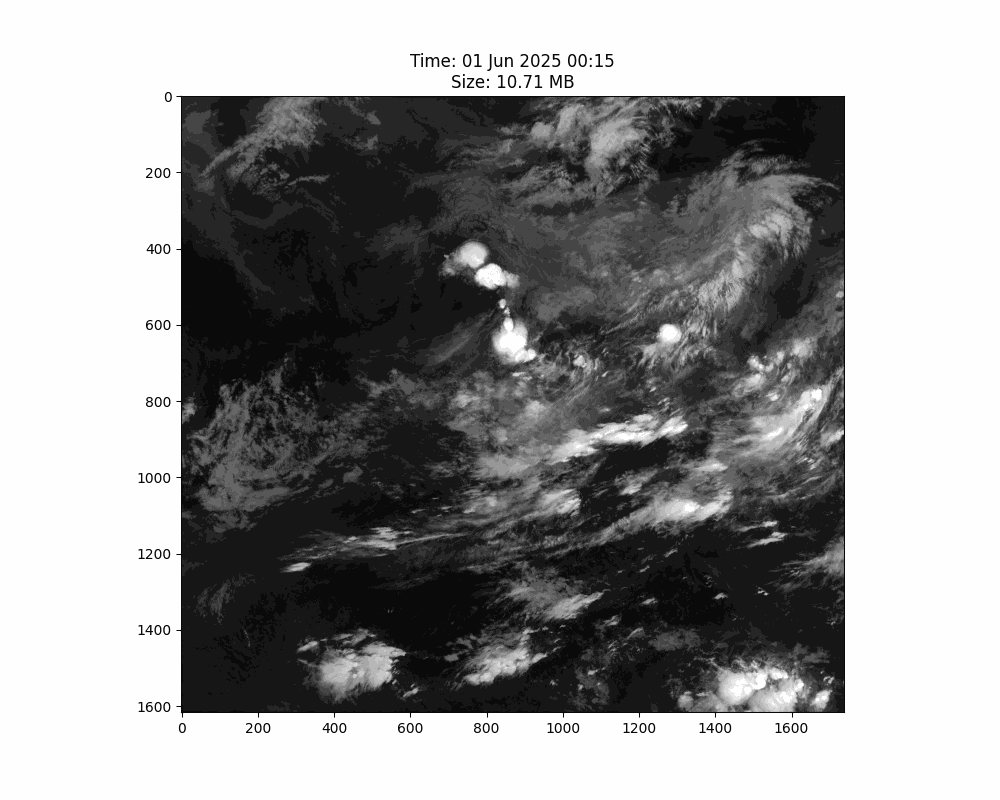

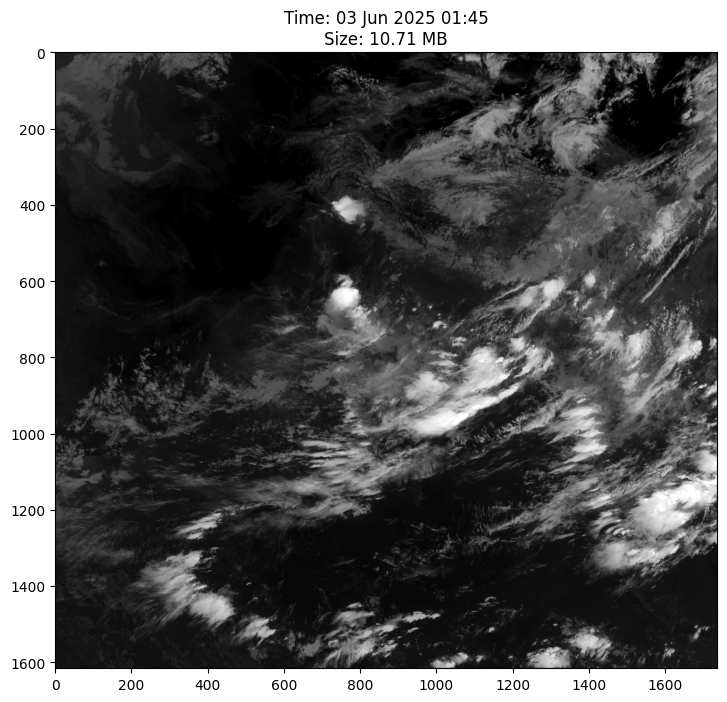

In [8]:
save_dir = Path('Animations_New')
save_name = 'clouds_motion_uncompressed_june.gif'
animate_clouds(
    frames=files,  # shape: (num_frames, H, W)
    data_paths=paths,  # list of same length as frames
    start_date_str="01JUN2025_0015",
    save_dir=save_dir,
    save_name=save_name
)


# Downsampling to Spatial dimension of ~10/12 km

In [10]:
files_downsampled = []
factor = 4  # Change to 3 or 4 if you want 12km or 16km resolution

for f in files:
    h, w = f.shape
    new_h = (h // factor) * factor
    new_w = (w // factor) * factor
    f_crop = f[:new_h, :new_w]

    # Use factor instead of hardcoded 4
    reshaped = f_crop.reshape(new_h // factor, factor, new_w // factor, factor)
    downsampled = reshaped.mean(axis=(1, 3))

    files_downsampled.append(downsampled)

files_downsampled = np.array(files_downsampled)
files_downsampled.shape # Decresae

(100, 404, 434)

In [11]:
np.save('downsampled_june_tir1_all_data_factor_4',files_downsampled)
_get_file_size(Path('/kaggle/working/downsampled_june_tir1_all_data_factor_4.npy'))

66.885498046875

# Animation Visualization Downsampled

In [12]:
def _get_array_size(arr):
    return arr.nbytes / (1024**2)  # Size in MB

def animate_clouds(frames, data_paths, start_date_str : str, save_dir : Path, save_name : str):
    # Convert '01JUL2025_0015' to datetime object
    start_dt = datetime.strptime(start_date_str, "%d%b%Y_%H%M")
    save_dir.mkdir(parents = True, exist_ok = True)

    # fig, ax = plt.subplots()
    fig, ax = plt.subplots(figsize=(10, 8)) 
    im = ax.imshow(frames[0], cmap='binary', animated=True)

    def _update(frame_idx):
        im.set_array(frames[frame_idx])
        curr_dt = start_dt + timedelta(minutes=30 * frame_idx)
        size = _get_array_size(frames[frame_idx])
        ax.set_title(f'Time: {curr_dt.strftime("%d %b %Y %H:%M")}\nSize: {size:.2f} MB')
        return [im]

    ani = FuncAnimation(fig, _update, frames=len(frames), interval=200, blit=True)

    save_path = Path(save_dir) / save_name
    ani.save(save_path, writer=PillowWriter(fps=5))
    print('Saved at', save_path)

    return Image(filename=save_path)


Saved at Animations_New/clouds_motion_compressed_june.gif


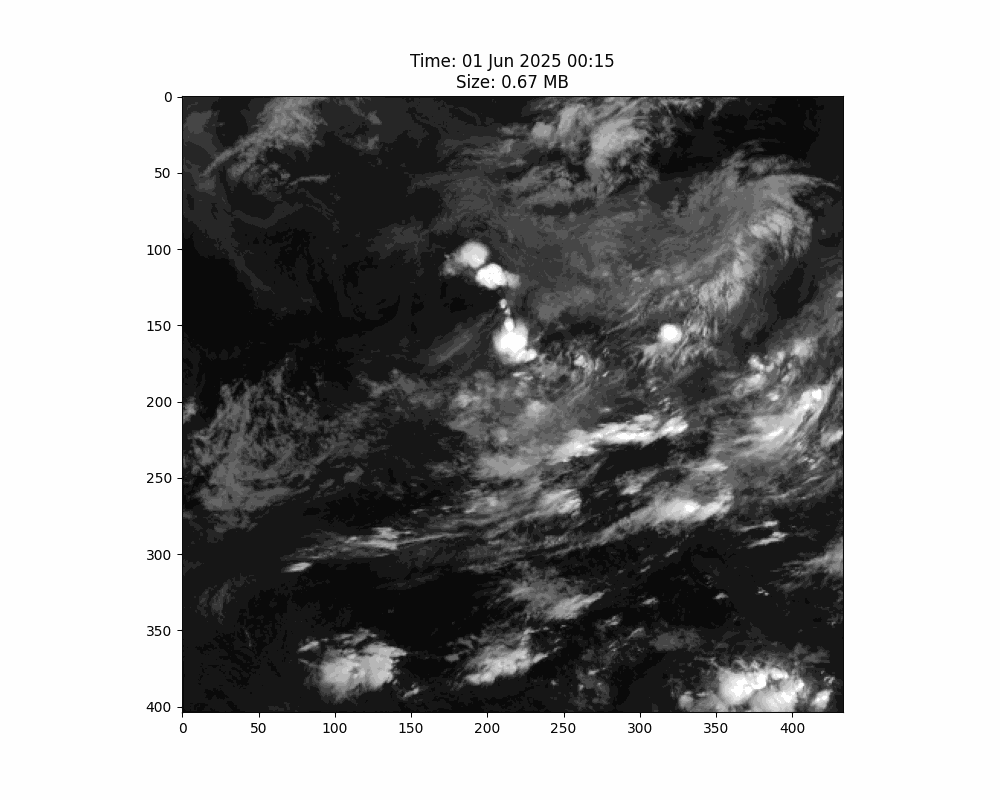

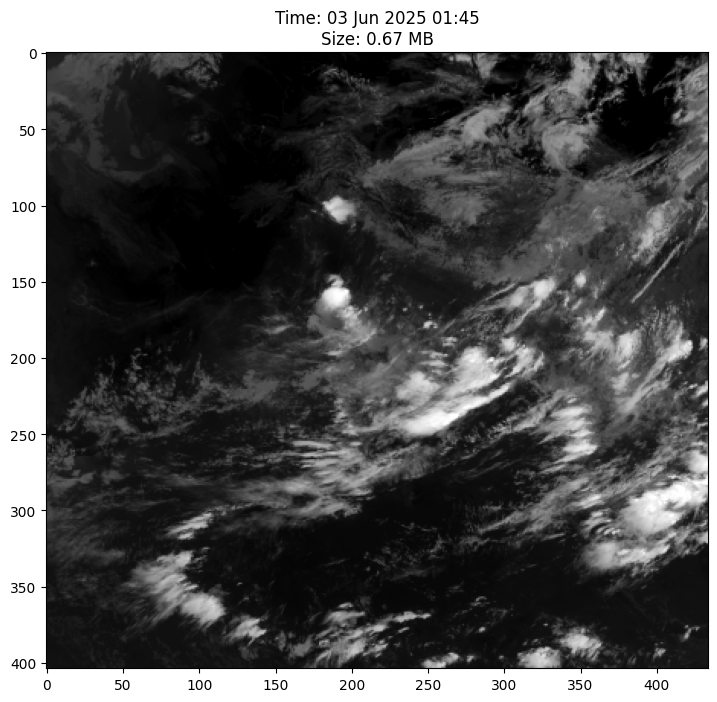

In [13]:
save_dir = Path('Animations_New')
save_name = 'clouds_motion_compressed_june.gif'
animate_clouds(
    frames=files_downsampled,  # shape: (num_frames, H, W)
    data_paths=paths,  # list of same length as frames
    start_date_str="01JUN2025_0015",
    save_dir=save_dir,
    save_name=save_name
)


# Side by Side visualization

In [14]:
def animate_side_by_side(original_frames, downsampled_frames, save_path="side_by_side.gif", cmap="inferno", fps=5):
    assert original_frames.shape[0] == downsampled_frames.shape[0], "Frame count mismatch"

    T = original_frames.shape[0]

    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    fig.suptitle(f"Original (Left) : {original_frames[0].shape} vs Downsampled (Right)  : {downsampled_frames[0].shape}", fontsize=14)

    im1 = axes[0].imshow(original_frames[0], cmap=cmap)
    axes[0].set_title("Original")
    axes[0].axis("off")

    im2 = axes[1].imshow(downsampled_frames[0], cmap=cmap)
    axes[1].set_title("Downsampled")
    axes[1].axis("off")

    def update(frame_idx):
        im1.set_array(original_frames[frame_idx])
        im2.set_array(downsampled_frames[frame_idx])
        return [im1, im2]

    ani = FuncAnimation(fig, update, frames=T, interval=1000 // fps, blit=True)
    ani.save(save_path, writer=PillowWriter(fps=fps))
    print(f"animation to {save_path}")

animation to comparison.gif


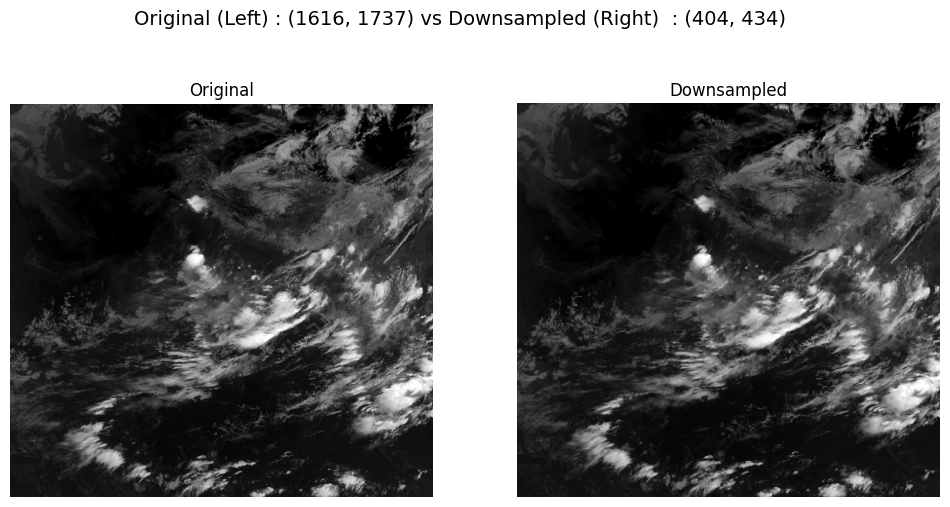

In [15]:
animate_side_by_side(np.array(files), files_downsampled, save_path="comparison.gif",cmap = "binary",fps = 32)
